In [ ]:
import cv2
from PIL import Image
# Inference on a single image from the train folder using the defined `train_images` path
filename = '2025-04-24-08-40-18_315.jpg'
img_path = os.path.join(train_images, filename)
if not os.path.exists(img_path):
    raise FileNotFoundError(f'Image not found: {img_path}')
# Load image
img = Image.open(img_path).convert('RGB')
# Apply the same transformation as for training
img_t = transform(img)
# Model expects a list of tensors
inputs = [img_t.to(device)]
# Model prediction
model.eval()
with torch.no_grad():
    predictions = model(inputs)
# Print the predicted bounding boxes and labels for the first (and only) image
print(predictions[0].get('boxes', []))
print(predictions[0].get('labels', []))
from torchvision.models.detection import fasterrcnn_resnet50_fpn
from torchvision.datasets import ImageFolder
from torchvision import transforms
import torchvision.transforms as T
from torchvision.models.detection.faster_rcnn import FastRCNNPredictor

In [4]:
# Load the pre-trained Faster R-CNN model with a ResNet-50 backbone
model = fasterrcnn_resnet50_fpn(pretrained=True)

# Number of classes (your dataset classes + 1 for background)
num_classes = 2  # For example, 2 classes + background

# Get the number of input features for the classifier
in_features = model.roi_heads.box_predictor.cls_score.in_features

# Replace the head of the model with a new one (for the number of classes in your dataset)
model.roi_heads.box_predictor = FastRCNNPredictor(in_features, num_classes)


/Users/adsonalves/Desktop/FIT/Aceleracoes/iasense_pipe/.venv/lib/python3.13/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/Users/adsonalves/Desktop/FIT/Aceleracoes/iasense_pipe/.venv/lib/python3.13/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=FasterRCNN_ResNet50_FPN_Weights.COCO_V1`. You can also use `weights=FasterRCNN_ResNet50_FPN_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


# Dataset

In [19]:
data_root = '/Users/adsonalves/Desktop/FIT/Aceleracoes/iasense_pipe/src/data'
train_images = os.path.join(data_root, 'train', 'images')
train_labels = os.path.join(data_root, 'train', 'labels')
val_images = os.path.join(data_root, 'val', 'images')
val_labels = os.path.join(data_root, 'val', 'labels')
output_dir = './checkpoints'  # onde serão salvos checkpoints e modelos
os.makedirs(output_dir, exist_ok=True)

In [20]:
# Dataset wrapper: lê rótulos YOLO e converte para o formato esperado pelo Faster R-CNN (xmin,ymin,xmax,ymax)
from PIL import Image
import glob

# Define transformations (e.g., resizing, normalization)
transform = T.Compose([
    T.ToTensor(),
])

class YOLOToFasterRCNNDataset(torch.utils.data.Dataset):
    """
    Dataset que lê imagens e arquivos de rótulos YOLO (cada linha: <class> <x_center> <y_center> <width> <height> no formato relativo [0-1])
    Retorna (image_tensor, target) onde target tem 'boxes' (Nx4, float32 em pixels no formato xmin,ymin,xmax,ymax) e 'labels' (N, int64)
    Assumptions:
      - image files têm extensão .jpg (ou qualquer extensão suportada pelo PIL) e os arquivos de labels têm o mesmo nome com extensão .txt dentro de `labels_dir`.
      - `classes_map` é um dict opcional para mapear classes do arquivo YOLO para índices inteiros (se None, usa a classe como int direto).
    """
    def __init__(self, images_dir, labels_dir, transforms=None, classes_map=None):
        self.images_dir = images_dir
        self.labels_dir = labels_dir
        # lista de caminhos de imagens ordenada (alinha com arquivos de label)
        exts = ('*.jpg', '*.jpeg', '*.png')
        imgs = []
        for e in exts:
            imgs.extend(sorted(glob.glob(os.path.join(images_dir, e))))
        self.images = imgs
        self.transforms = transforms
        self.classes_map = classes_map

    def __len__(self):
        return len(self.images)

    def _read_yolo_label(self, label_path, img_w, img_h):
        boxes = []
        labels = []
        if not os.path.exists(label_path):
            return boxes, labels
        with open(label_path, 'r') as f:
            for line in f.readlines():
                parts = line.strip().split()
                if len(parts) < 5:
                    continue
                cls = int(parts[0])
                x_c = float(parts[1])
                y_c = float(parts[2])
                w = float(parts[3])
                h = float(parts[4])
                # Convert relative coords to absolute pixel coords
                x_c_abs = x_c * img_w
                y_c_abs = y_c * img_h
                w_abs = w * img_w
                h_abs = h * img_h
                xmin = x_c_abs - (w_abs / 2.0)
                ymin = y_c_abs - (h_abs / 2.0)
                xmax = x_c_abs + (w_abs / 2.0)
                ymax = y_c_abs + (h_abs / 2.0)
                # Clamp to image
                xmin = max(0.0, xmin)
                ymin = max(0.0, ymin)
                xmax = min(img_w, xmax)
                ymax = min(img_h, ymax)
                boxes.append([xmin, ymin, xmax, ymax])
                # torchvision Faster R-CNN expects labels in [1..N] (0 is background),
                # so convert YOLO 0-based class index to 1-based label unless classes_map provided.
                if self.classes_map is not None:
                    mapped = self.classes_map.get(cls, cls)
                    labels.append(mapped + 1 if isinstance(mapped, int) else mapped)
                else:
                    labels.append(cls + 1)
        return boxes, labels

    def __getitem__(self, idx):
        img_path = self.images[idx]
        # assume label file has same basename but .txt
        base = os.path.splitext(os.path.basename(img_path))[0]
        label_path = os.path.join(self.labels_dir, base + '.txt')
        img = Image.open(img_path).convert('RGB')
        img_w, img_h = img.size
        boxes, labels = self._read_yolo_label(label_path, img_w, img_h)
        # Convert to tensors expected by torchvision Faster R-CNN
        if len(boxes) > 0:
            boxes_t = torch.tensor(boxes, dtype=torch.float32)
            labels_t = torch.tensor(labels, dtype=torch.int64)
        else:
            boxes_t = torch.zeros((0,4), dtype=torch.float32)
            labels_t = torch.zeros((0,), dtype=torch.int64)
        target = {}
        target['boxes'] = boxes_t
        target['labels'] = labels_t
        target['image_id'] = torch.tensor([idx])
        # area (optional but useful)
        areas = (boxes_t[:, 3] - boxes_t[:, 1]) * (boxes_t[:, 2] - boxes_t[:, 0]) if boxes_t.numel() else torch.tensor([], dtype=torch.float32)
        target['area'] = areas
        # iscrowd (all zeros)
        target['iscrowd'] = torch.zeros((boxes_t.shape[0],), dtype=torch.int64)
        # Apply transforms to image if provided (transforms should convert to tensor)
        if self.transforms is not None:
            img = self.transforms(img)
        return img, target


In [21]:
# Instantiate datasets for train and validation using the folders defined earlier
train_ds = YOLOToFasterRCNNDataset(train_images, train_labels, transforms=transform)
# If validation folder has images, use it; otherwise, split train into train/val
val_ds = YOLOToFasterRCNNDataset(val_images, val_labels, transforms=transform)

# collate function required by torchvision detection models
def collate_fn(batch):
    return tuple(zip(*batch))

# Create data loaders
train_loader = DataLoader(train_ds, batch_size=4, shuffle=True, collate_fn=collate_fn)
valid_loader = DataLoader(val_ds, batch_size=4, shuffle=False, collate_fn=collate_fn)

# Quick sanity print
print('Train samples:', len(train_ds), 'Val samples:', len(val_ds))

Train samples: 113 Val samples: 29


Target: {'boxes': tensor([[575., 581., 623., 641.],
        [467., 482., 540., 550.],
        [680., 372., 730., 441.],
        [594., 272., 670., 340.],
        [250., 206., 307., 264.],
        [507., 133., 561., 186.]]), 'labels': tensor([1, 1, 1, 1, 1, 1]), 'image_id': tensor([0]), 'area': tensor([2880., 4964., 3450., 5168., 3306., 2862.]), 'iscrowd': tensor([0, 0, 0, 0, 0, 0])}


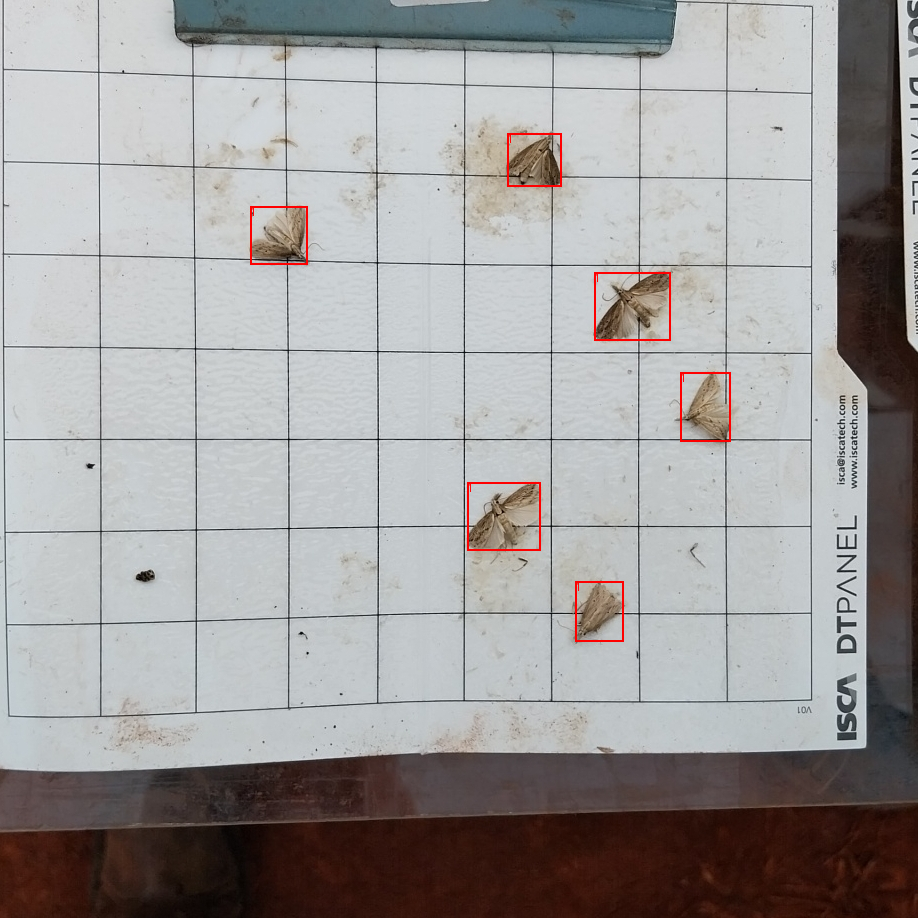

In [22]:
# Visual check: pegar um exemplo do dataset e desenhar as boxes e labels
import matplotlib.pyplot as plt
from PIL import Image, ImageDraw
# get a sample
sample_img, sample_target = train_ds[0] if len(train_ds) > 0 else (None, None)
print('Target:', sample_target)
if sample_img is not None:
    # sample_img is a tensor (C,H,W) - convert to PIL for drawing
    img_pil = transforms.ToPILImage()(sample_img)
    draw = ImageDraw.Draw(img_pil)
    for box, lbl in zip(sample_target['boxes'], sample_target['labels']):
        x1, y1, x2, y2 = box.tolist()
        draw.rectangle([x1, y1, x2, y2], outline='red', width=2)
        draw.text((x1, y1), str(int(lbl.item())), fill='red')
    display(img_pil)

In [23]:
# Move model to GPU if available
device = torch.device('cuda') if torch.cuda.is_available() else torch.device('cpu') 
model.to(device)

# Set up the optimizer
params = [p for p in model.parameters() if p.requires_grad]
optimizer = torch.optim.SGD(params, lr=0.005, momentum=0.9, 
                                                   weight_decay=0.0005)
# Learning rate scheduler
lr_scheduler = torch.optim.lr_scheduler.StepLR(optimizer, step_size=3, 
                                                               gamma=0.1)
# Train the model
num_epochs = 10
for epoch in range(num_epochs):
    model.train()
    train_loss = 0.0

   # Training loop
    for images, targets in train_loader:
        images = list(image.to(device) for image in images)
        targets = [{k: v.to(device) for k, v in t.items()} for t in targets]

        # Zero the gradients
        optimizer.zero_grad()

        # Forward pass
        loss_dict = model(images, targets)
        losses = sum(loss for loss in loss_dict.values())

        # Backward pass
        losses.backward()
        optimizer.step()
        train_loss += losses.item()

    # Update the learning rate
    lr_scheduler.step()
    print(f'Epoch: {epoch + 1}, Loss: {train_loss / len(train_loader)}')
print("Training complete!")

Epoch: 1, Loss: 1.2603393721169438
Epoch: 2, Loss: 0.5825610818534062
Epoch: 2, Loss: 0.5825610818534062
Epoch: 3, Loss: 0.4337637023679141
Epoch: 3, Loss: 0.4337637023679141
Epoch: 4, Loss: 0.352111102178179
Epoch: 4, Loss: 0.352111102178179
Epoch: 5, Loss: 0.3273016281169036
Epoch: 5, Loss: 0.3273016281169036
Epoch: 6, Loss: 0.3110567711550614
Epoch: 6, Loss: 0.3110567711550614
Epoch: 7, Loss: 0.30870977352405415
Epoch: 7, Loss: 0.30870977352405415
Epoch: 8, Loss: 0.31809564345869523
Epoch: 8, Loss: 0.31809564345869523
Epoch: 9, Loss: 0.3138930329988743
Epoch: 9, Loss: 0.3138930329988743
Epoch: 10, Loss: 0.3026001278696389
Training complete!
Epoch: 10, Loss: 0.3026001278696389
Training complete!


Batch 0 Image 0 - 21 boxes
boxes: tensor([[771.8990, 665.1422, 823.1380, 722.9943],
        [642.5950, 638.7269, 697.8719, 727.9550],
        [489.3393, 487.5613, 538.7010, 546.5207],
        [719.7762, 692.3810, 780.9230, 768.5581],
        [543.9651, 373.9688, 590.7014, 442.4594],
        [767.1391, 438.3584, 827.8888, 510.4950],
        [678.8202, 382.3818, 747.3074, 470.6760],
        [675.3555, 285.8582, 754.7579, 343.1745],
        [765.5167, 102.6797, 825.4158, 161.9523],
        [370.5800, 227.1093, 417.0740, 280.7309],
        [426.1811, 111.4415, 492.7108, 171.2630],
        [678.0782, 561.2899, 717.7738, 621.8545],
        [549.1694, 288.0201, 598.5766, 346.7462],
        [683.0576, 235.6685, 744.3237, 292.5335],
        [624.1368, 106.6677, 695.7744, 165.2098],
        [711.0015,  57.5215, 783.4691, 116.6806],
        [102.8635, 233.1009, 142.6000, 266.4705],
        [438.1784, 227.4040, 469.6557, 283.7522],
        [679.5839, 238.0983, 751.3553, 349.9773],
        [652.313

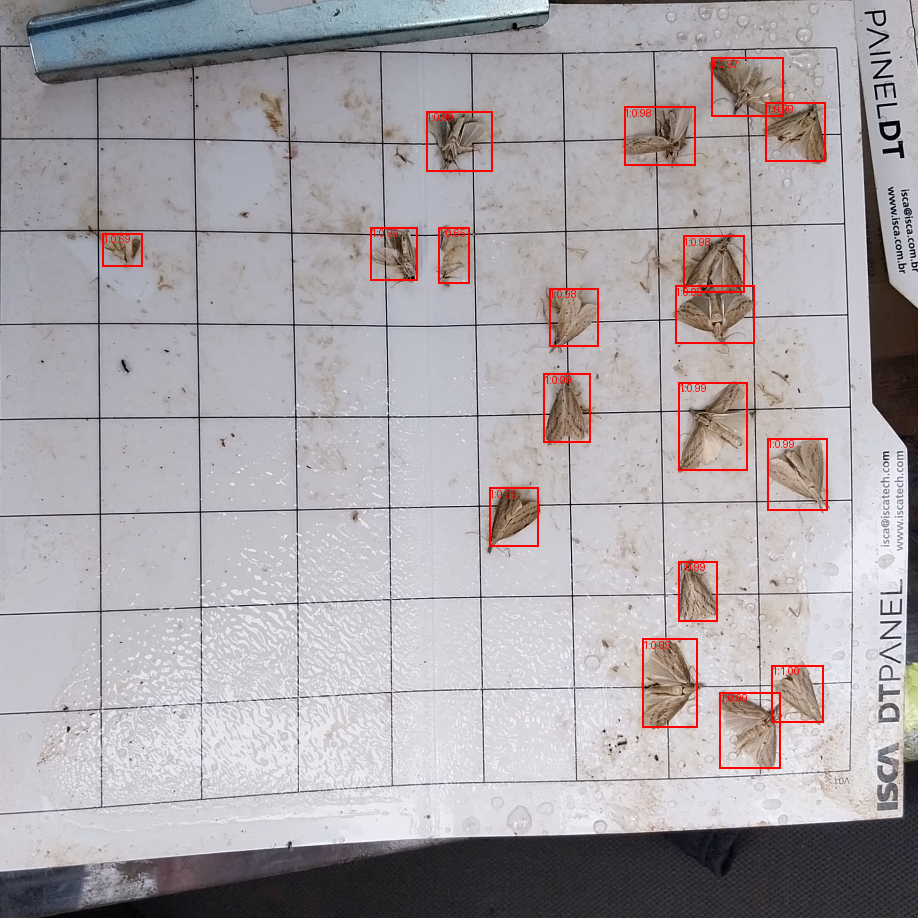

Batch 0 Image 1 - 17 boxes
boxes: tensor([[737.7972, 737.2949, 787.6325, 785.8135],
        [721.0673, 289.2882, 789.2364, 346.0443],
        [769.4929, 487.3290, 820.5187, 541.8609],
        [255.4588, 667.7120, 308.2300, 709.1640],
        [456.8803, 652.7563, 514.8812, 720.9180],
        [406.9467,  91.8438, 448.3888, 137.5376],
        [586.3173, 120.1867, 642.0096, 209.5948],
        [747.2211, 212.7267, 799.7120, 285.0017],
        [461.2378, 227.3143, 507.2035, 261.7565],
        [448.4083, 557.5022, 484.0537, 629.1741],
        [385.0583, 130.3893, 427.8168, 179.4673],
        [586.4475, 165.1669, 623.5291, 209.9027],
        [521.4742,  86.4749, 577.6299, 127.7909],
        [818.0035, 546.3126, 852.3978, 567.4734],
        [594.3948, 119.3699, 643.9167, 166.3840],
        [483.2758, 508.9933, 514.9084, 556.8350],
        [262.1395, 558.9975, 290.4778, 592.6830]])
labels: tensor([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1])
scores: tensor([0.9904, 0.9903, 0.9887, 0.9728,

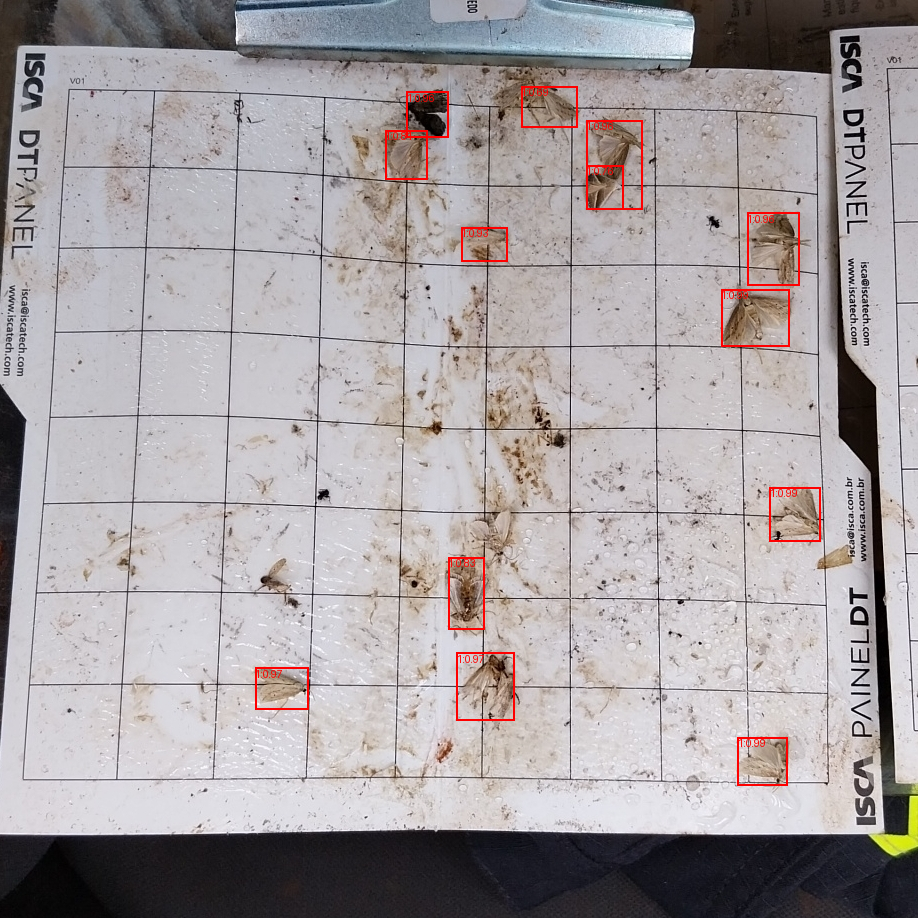

Batch 0 Image 2 - 3 boxes
boxes: tensor([[665.8319, 257.3060, 711.7079, 318.6552],
        [630.9340, 168.3371, 673.5116, 240.8708],
        [296.8953,   0.0000, 317.7004,  22.2672]])
labels: tensor([1, 1, 1])
scores: tensor([0.9878, 0.9689, 0.2361])


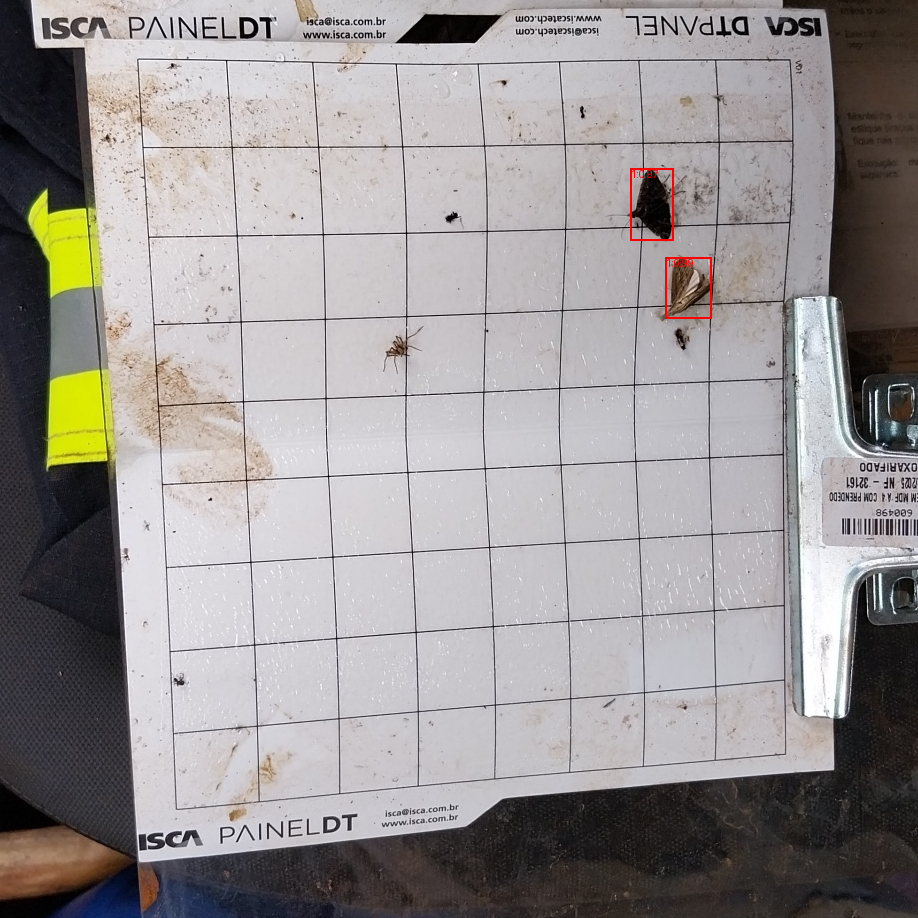

Batch 0 Image 3 - 9 boxes
boxes: tensor([[760.5021, 546.9664, 825.4163, 599.3529],
        [619.3727, 691.6977, 708.1936, 750.4408],
        [649.5411, 568.8629, 711.2021, 630.0986],
        [696.3760, 313.6021, 757.4585, 358.1434],
        [569.4114, 145.9175, 629.0443, 206.9431],
        [474.0105, 323.4362, 537.2900, 360.6162],
        [402.5341, 541.1797, 455.1519, 591.5010],
        [614.8504, 461.8827, 675.6083, 490.2484],
        [515.3576, 551.7240, 553.2103, 584.2673]])
labels: tensor([1, 1, 1, 1, 1, 1, 1, 1, 1])
scores: tensor([0.9932, 0.9929, 0.9910, 0.9909, 0.9898, 0.9739, 0.9712, 0.9279, 0.4981])


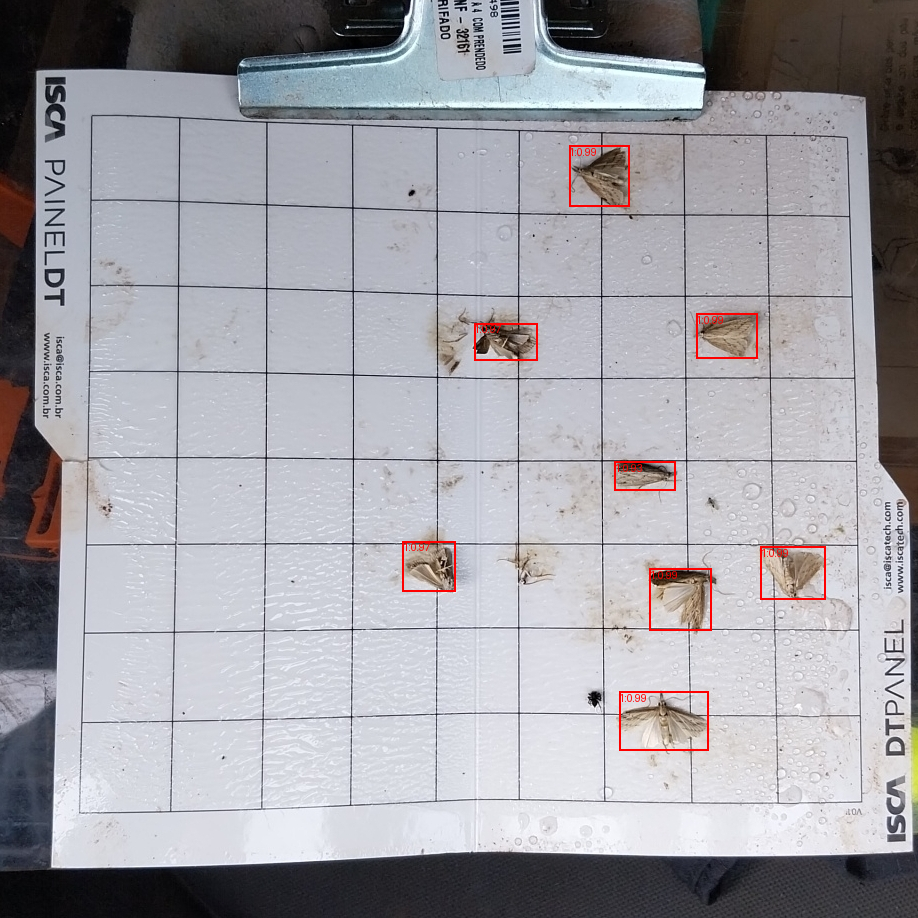

Batch 1 Image 0 - 6 boxes
boxes: tensor([[212.8829, 611.5254, 258.7686, 653.7159],
        [323.9221, 537.6733, 361.2456, 578.6296],
        [390.0775, 782.0853, 425.3710, 815.2452],
        [839.5214, 321.2263, 913.2728, 399.5282],
        [257.5681, 807.2516, 281.3203, 852.1677],
        [855.4651, 325.9346, 895.4550, 393.6062]])
labels: tensor([1, 1, 1, 1, 1, 1])
scores: tensor([0.9897, 0.9836, 0.4162, 0.1826, 0.0858, 0.0540])


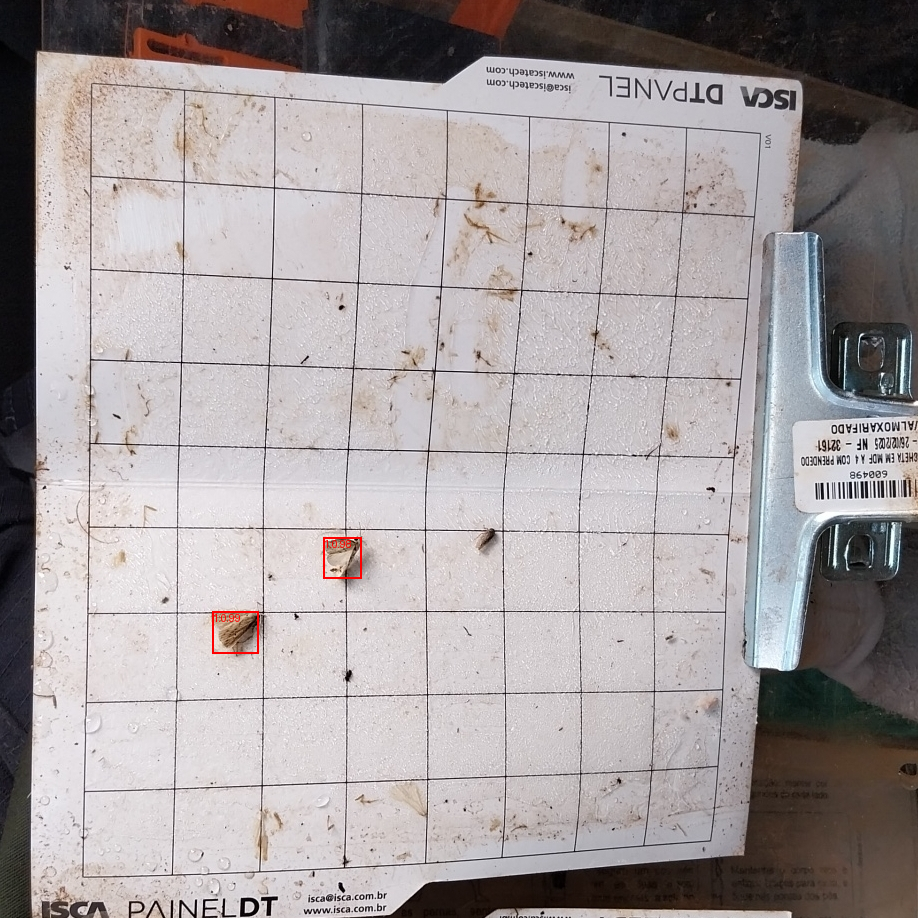

Batch 1 Image 1 - 7 boxes
boxes: tensor([[169.8392, 341.4924, 228.6541, 387.8342],
        [692.1217, 410.4292, 728.4355, 430.0034],
        [435.2059, 567.6453, 475.5729, 588.7776],
        [251.7229, 446.5942, 272.4088, 489.7082],
        [529.9078, 459.2148, 562.2664, 479.9590],
        [661.9419, 338.6652, 681.2711, 378.8416],
        [189.5758, 349.1001, 225.6086, 386.2418]])
labels: tensor([1, 1, 1, 1, 1, 1, 1])
scores: tensor([0.9852, 0.2868, 0.2360, 0.1252, 0.0819, 0.0801, 0.0533])


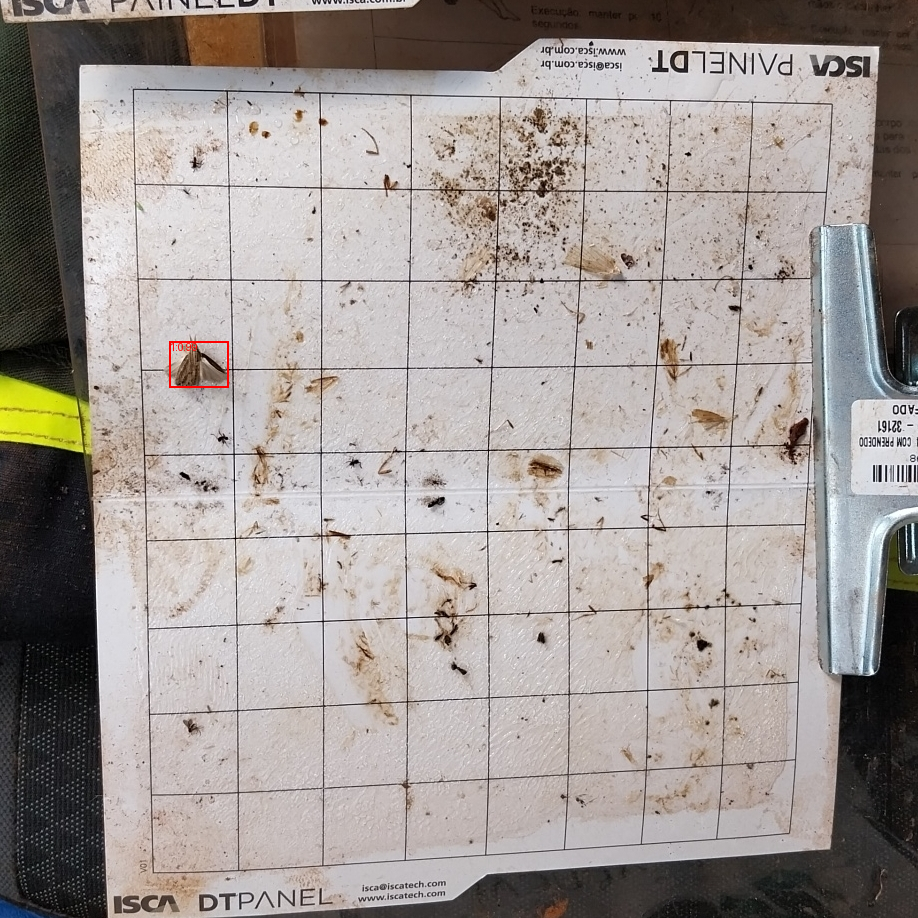

Batch 1 Image 2 - 3 boxes
boxes: tensor([[135.8139, 569.4469, 202.9555, 627.5084],
        [338.9693, 325.8405, 390.7858, 383.1122],
        [684.6750, 250.6581, 723.3969, 282.7678]])
labels: tensor([1, 1, 1])
scores: tensor([0.9940, 0.9928, 0.3414])


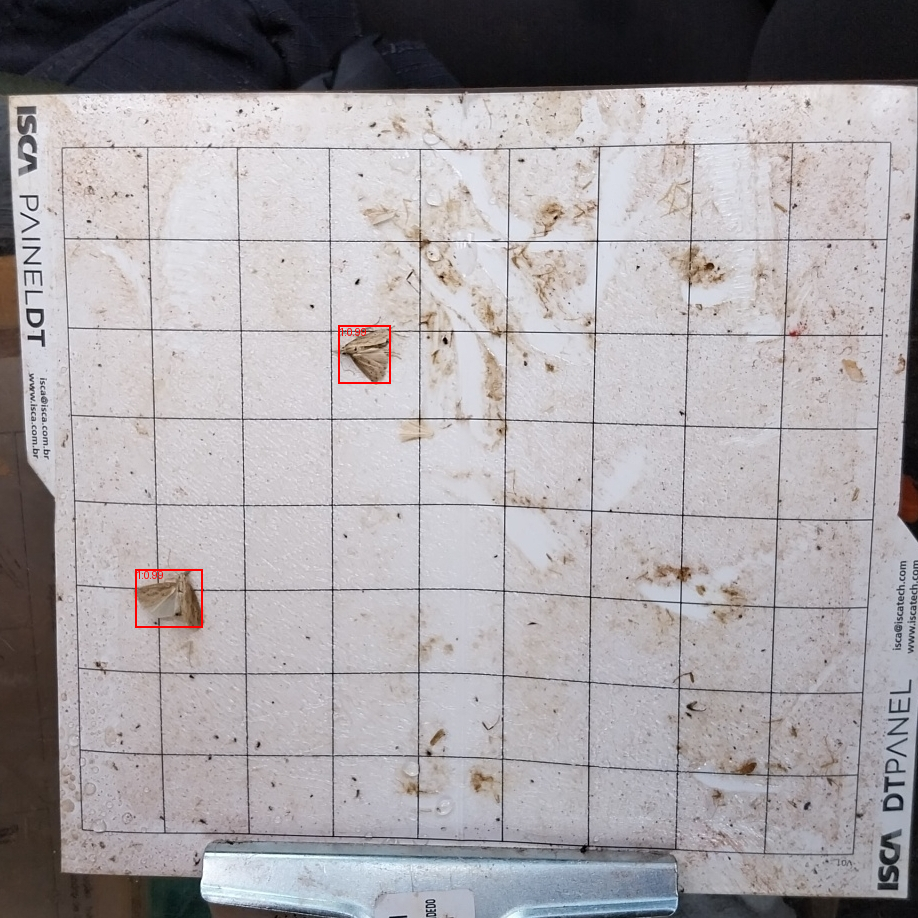

Batch 1 Image 3 - 10 boxes
boxes: tensor([[462.5713, 748.8571, 515.1713, 801.0485],
        [450.3164, 409.6254, 509.1260, 466.1546],
        [353.4354, 383.4723, 398.8906, 460.4719],
        [ 83.8638, 436.6503, 138.9545, 473.5175],
        [145.8910, 464.4934, 181.8188, 555.3411],
        [327.3658, 380.9514, 369.2569, 419.2052],
        [355.9076, 411.1328, 391.7656, 459.4366],
        [364.3153, 382.0535, 398.3794, 435.1700],
        [333.7633, 388.1926, 400.4224, 425.2695],
        [329.3968, 377.1079, 385.2713, 441.7933]])
labels: tensor([1, 1, 1, 1, 1, 1, 1, 1, 1, 1])
scores: tensor([0.9950, 0.9898, 0.9718, 0.8928, 0.8400, 0.4918, 0.1861, 0.1303, 0.0807,
        0.0580])


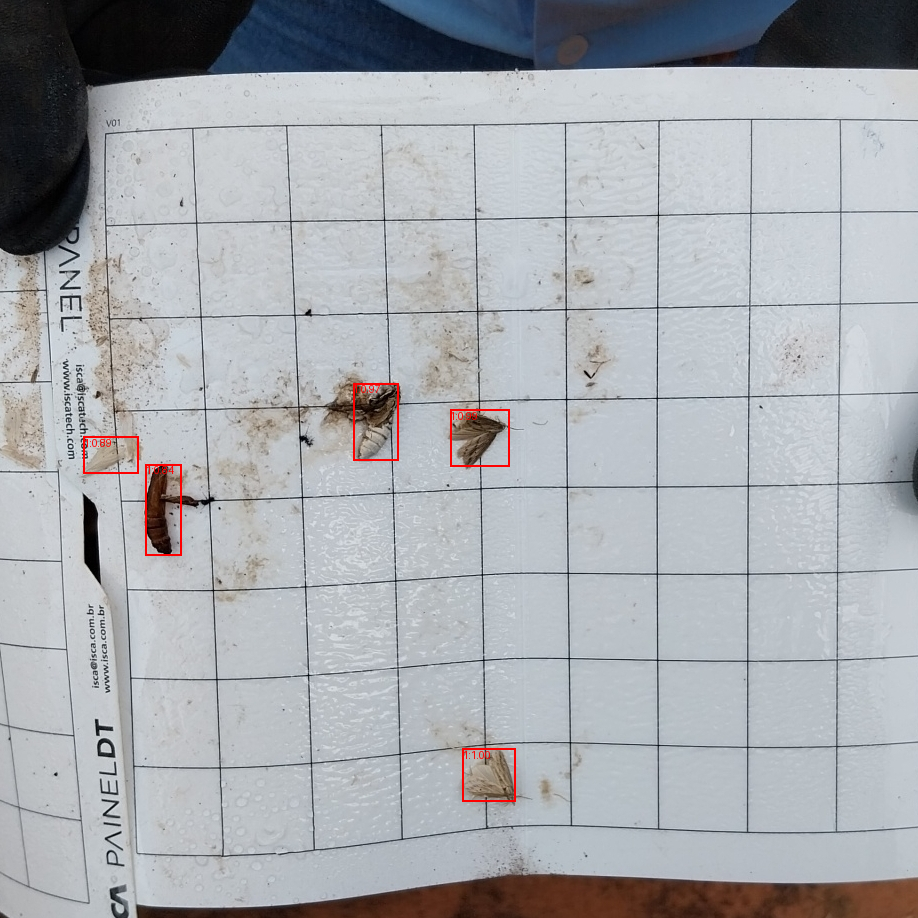

Batch 2 Image 0 - 21 boxes
boxes: tensor([[ 73.9836, 617.3078, 132.7585, 668.5035],
        [413.4756, 530.3400, 469.2643, 573.3702],
        [331.9858, 266.0190, 393.8383, 326.1801],
        [651.4683, 414.0282, 697.5892, 457.0191],
        [110.1872, 387.4209, 170.9754, 428.7311],
        [ 37.2988,  30.3964,  88.5297,  67.3774],
        [188.5328, 110.4278, 236.6256, 166.1515],
        [255.2996, 606.8838, 290.9461, 660.0853],
        [471.8906, 382.2076, 514.0175, 435.6432],
        [536.9770, 301.5181, 581.1907, 356.1573],
        [708.8657, 284.0418, 757.7023, 346.5518],
        [407.7893, 335.1168, 464.1000, 373.2916],
        [613.8010, 496.5813, 647.3539, 531.0793],
        [604.0242, 432.6788, 646.0536, 469.7326],
        [304.3778, 507.8690, 345.2106, 548.8599],
        [353.6447, 332.5493, 406.9755, 385.0154],
        [ 46.0264, 103.3829,  70.4449, 145.8142],
        [ 94.2191, 536.0739, 136.9845, 576.0876],
        [158.2085, 460.2510, 204.2486, 498.7967],
        [661.132

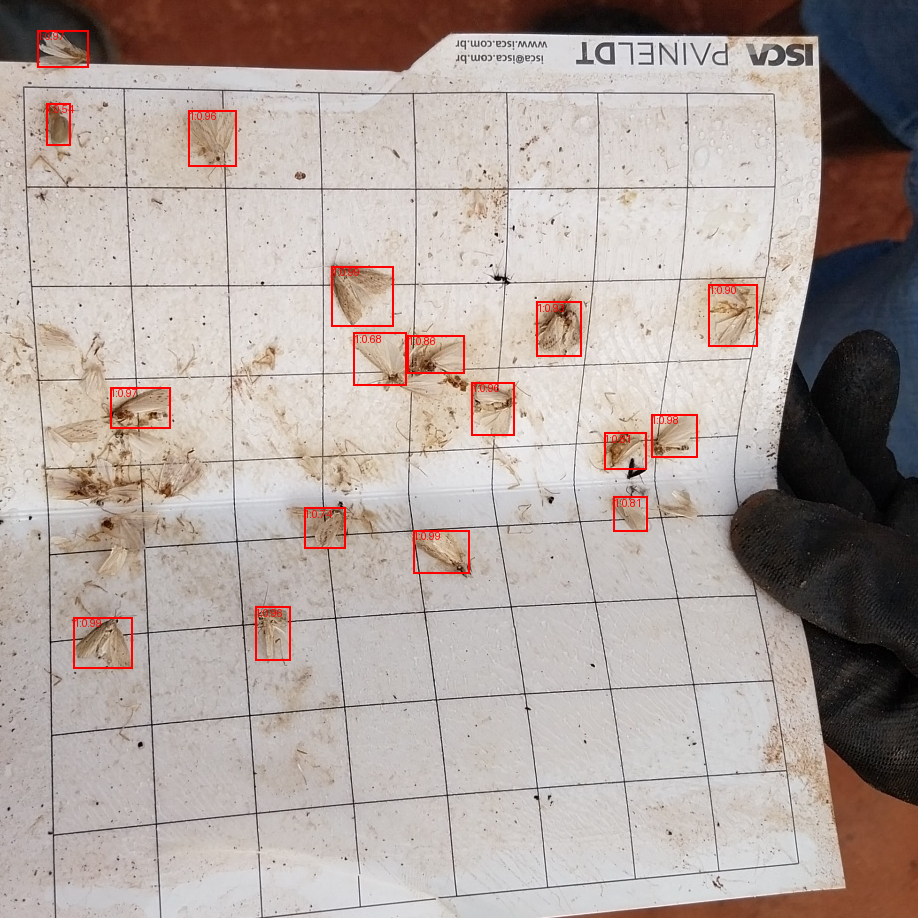

Batch 2 Image 1 - 15 boxes
boxes: tensor([[305.9173, 585.5450, 391.8193, 649.8355],
        [672.7777, 552.3481, 713.1184, 611.6896],
        [733.7491, 568.9963, 810.0342, 645.7930],
        [163.8337, 381.0843, 214.6130, 426.9748],
        [142.7612, 760.1032, 194.9346, 840.3339],
        [595.2412, 632.3268, 666.7587, 690.8456],
        [423.7559, 508.1358, 484.4538, 575.8132],
        [385.8428, 419.3954, 419.1553, 470.1230],
        [503.9006, 595.2479, 555.2977, 641.4534],
        [183.0015, 500.1940, 243.8982, 548.4974],
        [783.3039, 679.7831, 844.7199, 725.7095],
        [183.0740, 512.1680, 233.4393, 602.4636],
        [334.7685, 586.3145, 391.3342, 633.7667],
        [188.0219, 887.6517, 230.8842, 916.8480],
        [630.9103, 635.7510, 665.0197, 689.7985]])
labels: tensor([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1])
scores: tensor([0.9900, 0.9893, 0.9836, 0.9832, 0.9816, 0.9757, 0.9412, 0.9399, 0.8897,
        0.6130, 0.5141, 0.3997, 0.0844, 0.0610, 0.0603])


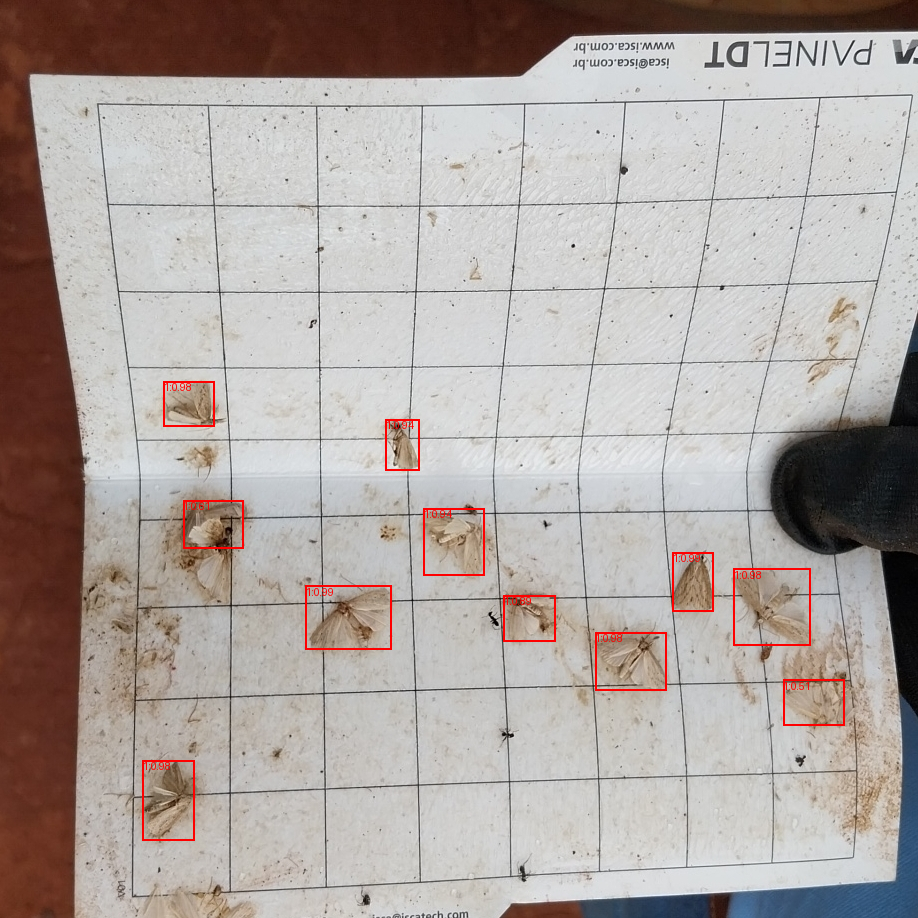

Batch 2 Image 2 - 15 boxes
boxes: tensor([[240.6879, 735.2354, 315.3271, 799.4910],
        [260.5826, 331.6526, 320.9257, 404.8034],
        [518.4998, 223.9506, 571.4820, 271.9906],
        [144.6946, 214.4869, 210.4525, 295.9029],
        [174.4730, 126.9872, 233.4949, 189.0486],
        [237.3329, 190.6611, 297.1061, 267.7986],
        [119.9914, 431.0642, 164.5902, 465.0670],
        [107.5272, 140.6443, 143.3285, 195.5075],
        [485.1943, 805.7075, 517.1901, 856.0265],
        [516.7117, 801.9549, 565.4211, 843.2236],
        [407.7831, 607.4697, 438.5668, 651.4733],
        [171.8221, 159.9850, 232.0910, 188.8140],
        [ 67.2174, 138.7402, 116.3804, 170.8153],
        [148.9464, 217.3216, 210.8908, 259.1333],
        [235.5266, 229.4223, 291.7729, 265.1984]])
labels: tensor([1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1])
scores: tensor([0.9976, 0.9949, 0.9902, 0.9879, 0.9872, 0.9812, 0.9325, 0.9203, 0.8901,
        0.7750, 0.6264, 0.6034, 0.1584, 0.1199, 0.0522])


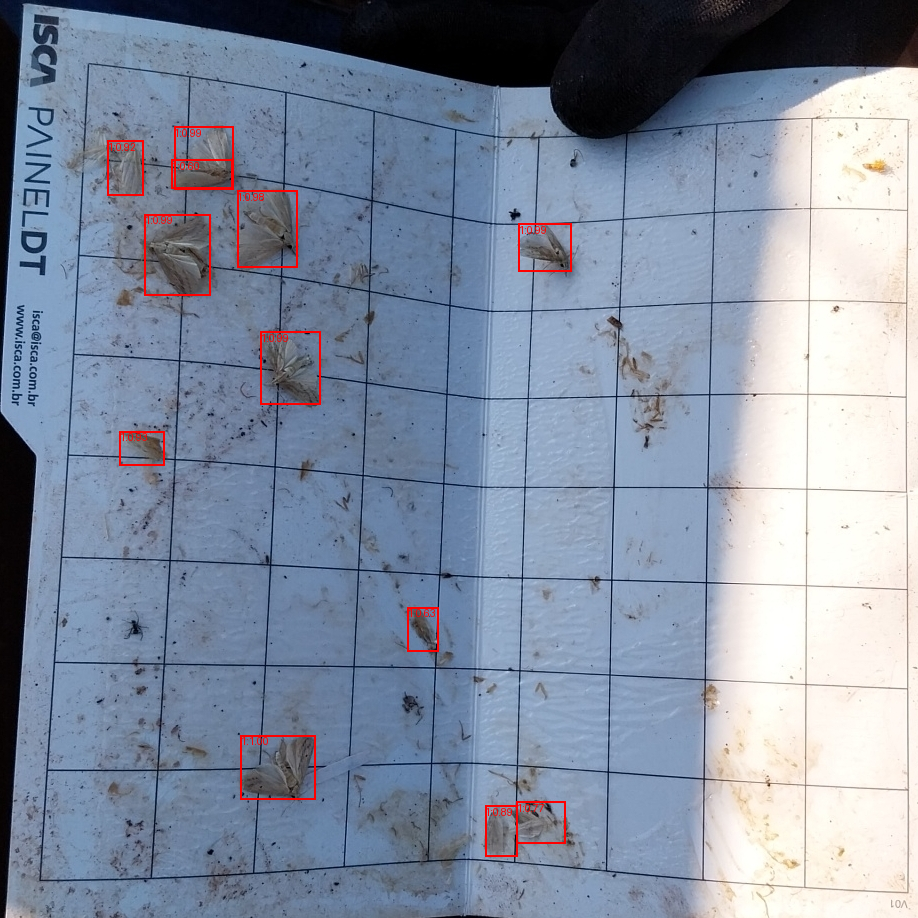

Batch 2 Image 3 - 33 boxes
boxes: tensor([[595.7687, 485.1753, 631.1204, 551.2844],
        [429.0512, 152.8602, 469.1951, 222.3961],
        [649.3643, 740.7928, 718.8246, 804.9570],
        [290.6114, 161.1562, 363.1891, 212.1374],
        [218.6482, 221.9136, 275.8591, 268.6702],
        [344.1695, 228.0413, 402.3858, 281.4511],
        [141.3481, 182.5876, 196.4532, 223.3266],
        [525.2306, 599.0770, 576.6495, 640.5128],
        [674.8152, 819.2703, 715.4809, 867.7507],
        [637.5540, 271.5788, 691.6367, 309.3488],
        [427.0494, 465.0359, 480.2861, 534.6819],
        [227.1448, 577.1802, 285.3676, 654.7888],
        [457.1203, 317.8051, 490.8272, 370.9116],
        [131.7690,  95.4212, 185.6315, 162.3046],
        [247.2486, 254.1358, 293.7680, 303.5903],
        [448.8700, 231.6267, 490.0574, 290.1024],
        [431.2807, 278.5022, 465.0401, 326.6627],
        [315.1687, 355.7072, 387.0210, 411.7691],
        [368.9416, 320.4355, 410.8387, 381.3853],
        [351.678

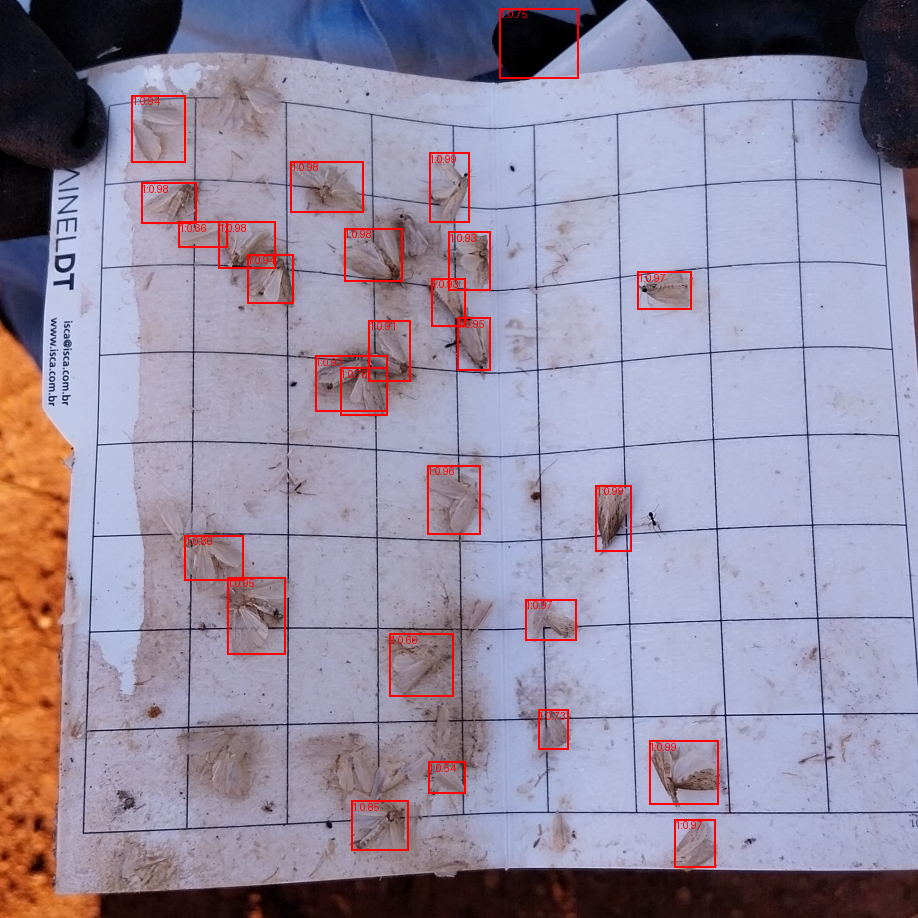

In [ ]:
# ...existing code...
# Replaced evaluation cell: safer loop, moves tensors to cpu for printing and optional visualization
import torchvision.transforms as Tvis
from PIL import Image, ImageDraw
import matplotlib.pyplot as plt

model.eval()
with torch.no_grad():
    for batch_i, (images, targets) in enumerate(valid_loader):
        # move inputs to device
        images = list(img.to(device) for img in images)
        outputs = model(images)  # list[dict] on device

        for i, output in enumerate(outputs):
            boxes = output.get('boxes', torch.empty((0,4))).cpu()
            labels = output.get('labels', torch.empty((0,), dtype=torch.int64)).cpu()
            scores = output.get('scores', torch.empty((0,))).cpu()

            print(f'Batch {batch_i} Image {i} - {len(boxes)} boxes')
            print('boxes:', boxes)
            print('labels:', labels)
            print('scores:', scores)

            # optional quick visualization of high-confidence detections
            score_thresh = 0.5
            if scores.numel() and (scores > score_thresh).any():
                keep = (scores > score_thresh).nonzero(as_tuple=False).squeeze(1)
                # reconstruct PIL image from the tensor used as input (assumes transforms include ToTensor)
                img_tensor = images[i].cpu()
                img_pil = Tvis.ToPILImage()(img_tensor)
                draw = ImageDraw.Draw(img_pil)
                for idx in keep.tolist():
                    x1, y1, x2, y2 = boxes[idx].tolist()
                    draw.rectangle([x1, y1, x2, y2], outline='red', width=2)
                    draw.text((x1, y1), f'{int(labels[idx].item())}:{scores[idx]:.2f}', fill='red')
                display(img_pil)

        # limit number of batches printed/visualized during quick checks
        if batch_i >= 2:
            break


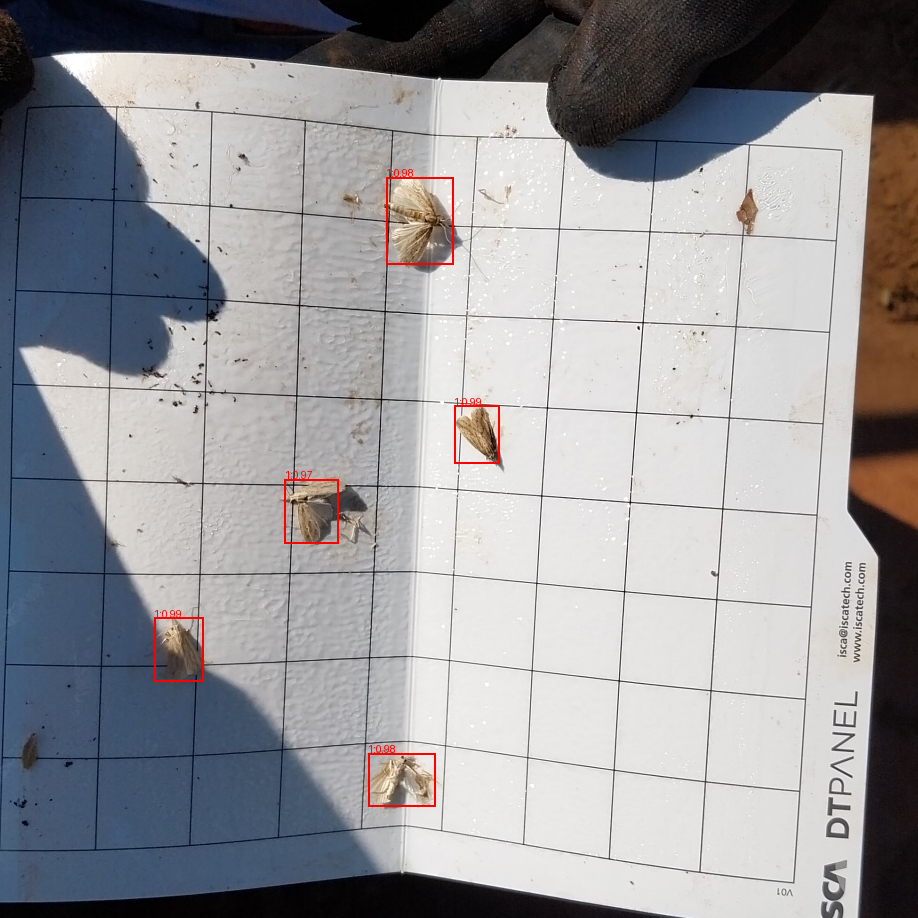

In [32]:

# Single-image inference + visualização (corrigido e enxuto)
from PIL import Image, ImageDraw
from IPython.display import display

filename = '2025-05-02-09-52-35_433.jpg'
img_path = os.path.join(val_images, filename)

if not os.path.exists(img_path):
    print('Image not found at', img_path)
else:
    img = Image.open(img_path).convert('RGB')
    img_t = transform(img)
    inputs = [img_t.to(device)]
    model.eval()
    with torch.no_grad():
        pred = model(inputs)[0]

    boxes = pred.get('boxes', torch.empty((0,4))).cpu()
    labels = pred.get('labels', torch.empty((0,), dtype=torch.int64)).cpu()
    scores = pred.get('scores', torch.empty((0,))).cpu()

    score_thresh = 0.5
    drawn = img.copy()
    d = ImageDraw.Draw(drawn)
    keep = (scores > score_thresh).nonzero(as_tuple=True)[0].tolist()
    if not keep:
        print('Nenhuma detecção acima do limiar:', score_thresh)
    for j in keep:
        x1, y1, x2, y2 = boxes[j].tolist()
        d.rectangle([x1, y1, x2, y2], outline='red', width=2)
        d.text((x1, max(0, y1-10)), f'{int(labels[j].item())}:{scores[j]:.2f}', fill='red')

    display(drawn)
